In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
from pandas_profiling import ProfileReport

In [2]:
data = pd.read_csv('all_patents_granted_and pregrant.csv', dtype= {'GEOID' : 'str'}, low_memory = False)
data

,patent_number,assignee,grant_year,application_year,application_number,GEOID,ipc_section,team_size,inventors,men_inventors,women_inventors,already_granted
0,7472428,"NIKE, INC.",2009.0,2004,10814594,41067,A,2,2,2.0,0,1
1,7472496,"NIKE, INC.",2009.0,2005,11055158,41067,A,2,2,1.0,1,1
2,7472634,"SD3, LLC",2009.0,2004,10923290,41067,B,3,3,3.0,0,1
3,7474419,FEI COMPANY,2009.0,2006,11590583,41067,G,6,6,5.0,1,1
4,7474972,"TEKTRONIX, INC.",2009.0,2007,11690797,41067,G,3,3,3.0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
2267740,NaN,Jaber Technology Holdings US Inc,NaN,2019,16425130,48209,NaN,3,3,3.0,0,0
2267741,NaN,"Roche Diagnostics Operations, Inc.",NaN,2019,16425160,18097,NaN,2,2,1.0,1,0
2267742,NaN,"Theravance Biopharma R&D IP, LLC",NaN,2019,16425166,06081,NaN,2,2,2.0,0,0
2267743,NaN,Intel Corporation,NaN,2019,16424945,06085,NaN,3,3,3.0,0,0


In [24]:
#data.info()

In [3]:
data = data.assign(percent_women = round(100*(data.women_inventors/data.team_size),1),
                  percent_men = round(100*(data.men_inventors/data.team_size),1))
data

,patent_number,assignee,grant_year,application_year,application_number,GEOID,ipc_section,team_size,inventors,men_inventors,women_inventors,already_granted,percent_women,percent_men
0,7472428,"NIKE, INC.",2009.0,2004,10814594,41067,A,2,2,2.0,0,1,0.0,100.0
1,7472496,"NIKE, INC.",2009.0,2005,11055158,41067,A,2,2,1.0,1,1,50.0,50.0
2,7472634,"SD3, LLC",2009.0,2004,10923290,41067,B,3,3,3.0,0,1,0.0,100.0
3,7474419,FEI COMPANY,2009.0,2006,11590583,41067,G,6,6,5.0,1,1,16.7,83.3
4,7474972,"TEKTRONIX, INC.",2009.0,2007,11690797,41067,G,3,3,3.0,0,1,0.0,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2267740,NaN,Jaber Technology Holdings US Inc,NaN,2019,16425130,48209,NaN,3,3,3.0,0,0,0.0,100.0
2267741,NaN,"Roche Diagnostics Operations, Inc.",NaN,2019,16425160,18097,NaN,2,2,1.0,1,0,50.0,50.0
2267742,NaN,"Theravance Biopharma R&D IP, LLC",NaN,2019,16425166,06081,NaN,2,2,2.0,0,0,0.0,100.0
2267743,NaN,Intel Corporation,NaN,2019,16424945,06085,NaN,3,3,3.0,0,0,0.0,100.0


In [49]:
data.iloc[1]

patent_number            7472496
assignee              NIKE, INC.
grant_year                2009.0
application_year            2005
application_number      11055158
GEOID                      41067
ipc_section                    A
team_size                      2
inventors                      2
men_inventors                1.0
women_inventors                1
already_granted                1
percent_women               50.0
percent_men                 50.0
Name: 1, dtype: object

In [4]:
#data.groupby(['application_year', 'GEOID', 'already_granted'], as_index = False).size()
data.groupby(['application_year', 'GEOID'], as_index = False).size().sort_values(by ='size', ascending = False). head(20)

,application_year,GEOID,size
14774,2013,6085,20074
16374,2014,6085,20062
13171,2012,6085,19553
17918,2015,6085,18154
12508,2012,36119,17780
19479,2016,6085,17094
11587,2011,6085,15741
14115,2013,36119,14975
13301,2013,06085,13126
20974,2017,6085,12596


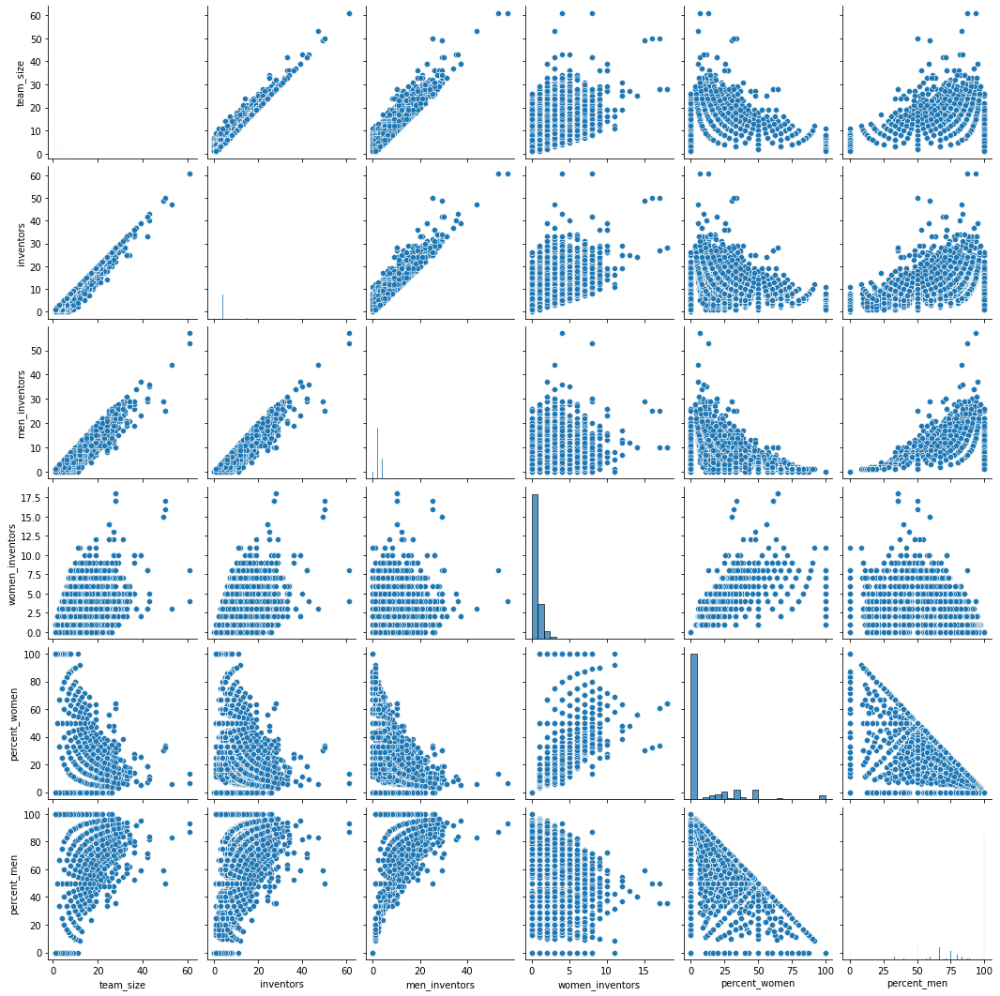

In [5]:
mat_fun = data.query("application_year >= 2009")[['team_size', 
                                         'inventors','men_inventors', 
                                         'women_inventors',
                                         'percent_women','percent_men']]
sns.pairplot(mat_fun) 

In [6]:
my_corr = mat_fun.corr()

Text(0.5, 1.0, 'Correlation Between Baisc Patent Info')

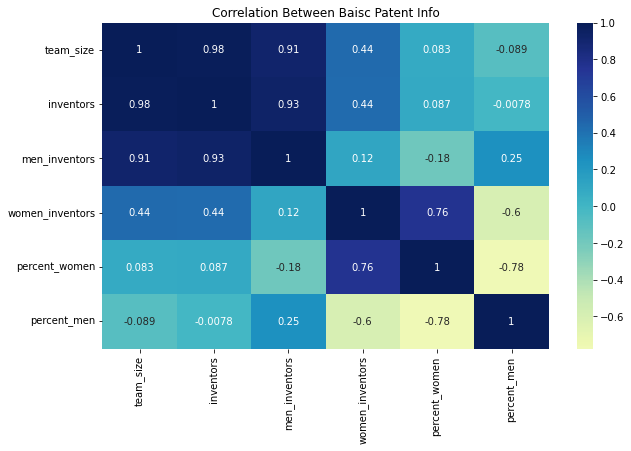

In [7]:
plt.figure(figsize = (10,6))
sns.heatmap(my_corr, center=0,  annot=True, cmap='YlGnBu')
plt.title("Correlation Between Baisc Patent Info")

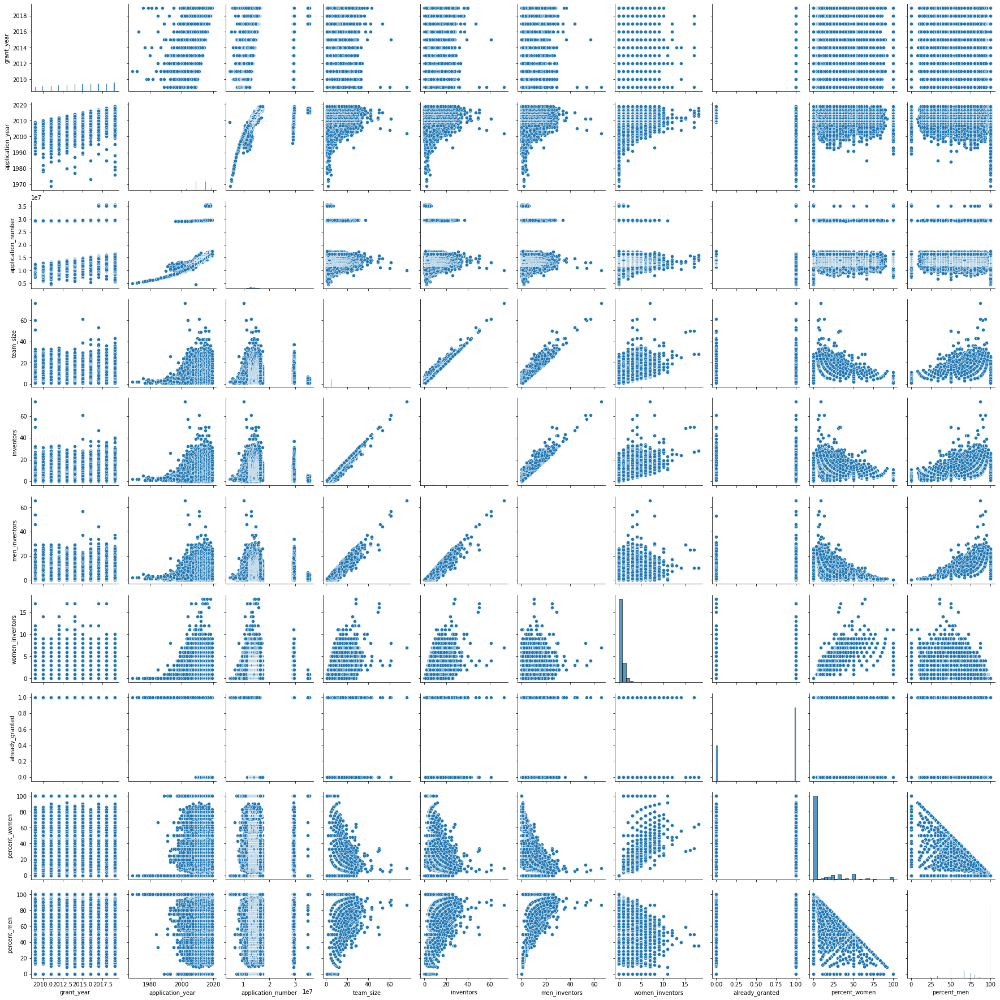

In [8]:
sns.pairplot(data) 

In [ ]:
profile = ProfileReport(data,
                        title = 'Patents_Granted_and_PreGrant',
                        html = {'style':{'full_width': True}},
                        minimal = False)

profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

## Visuals 

- number of total men and women inventors by year
    - separate by grant and no grant
- look at the ratio's of women 

In [25]:
sex_by_year_and_status = data.query("application_year >= 2009").groupby(['application_year', 'already_granted'], as_index = False).\
agg({'men_inventors':'sum','women_inventors':'sum'})

In [26]:
sex_hist = pd.melt(sex_by_year_and_status, id_vars = ['application_year', 'already_granted'], 
                    value_vars = ['men_inventors', 'women_inventors'])
sex_hist = sex_hist.rename({'variable':'sex',
                             'value':'total_inventors'}, axis=1)

sex_hist

,application_year,already_granted,sex,total_inventors
0,2009,0,men_inventors,173209.0
1,2009,1,men_inventors,240560.0
2,2010,0,men_inventors,196735.0
3,2010,1,men_inventors,262098.0
4,2011,0,men_inventors,226718.0
5,2011,1,men_inventors,289722.0
6,2012,0,men_inventors,281679.0
7,2012,1,men_inventors,332163.0
8,2013,0,men_inventors,295653.0
9,2013,1,men_inventors,352757.0


Text(0.5, 1.0, 'Total Inventors against Application Year by Sex of Granted Patents')

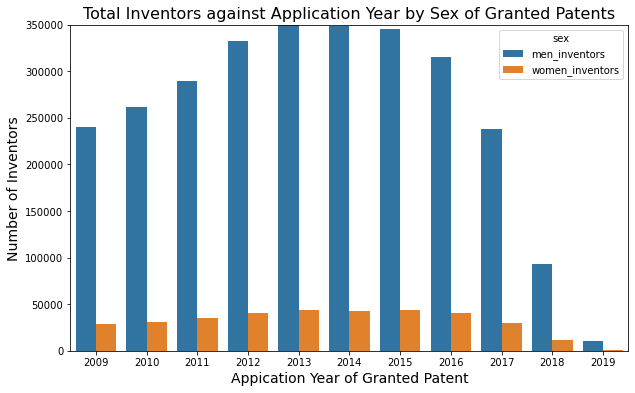

In [27]:
plt.figure(figsize = (10,6))
sns.barplot(x = 'application_year',
            y ='total_inventors', 
            hue='sex',
            data=sex_hist.query("already_granted == 1"))
plt.ylim(0,350000)
plt.xlabel("Appication Year of Granted Patent", fontsize = 14)
plt.ylabel("Number of Inventors",fontsize = 14)
plt.title("Total Inventors against Application Year by Sex of Granted Patents", fontsize = 16)

Text(0.5, 1.0, 'Total Inventors against Application Year by Sex of PREgrant Patents')

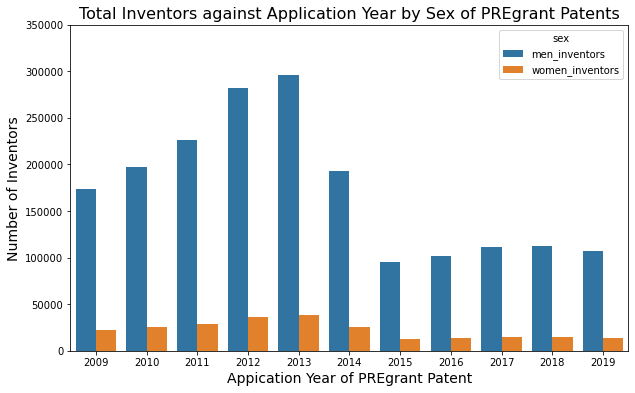

In [28]:
plt.figure(figsize = (10,6))
sns.barplot(x = 'application_year',
            y ='total_inventors', 
            hue='sex',
            data=sex_hist.query("already_granted == 0"))
plt.ylim(0,350000)
plt.xlabel("Appication Year of PREgrant Patent", fontsize = 14)
plt.ylabel("Number of Inventors",fontsize = 14)
plt.title("Total Inventors against Application Year by Sex of PREgrant Patents", fontsize = 16)

Text(0, 0.5, 'Percent Women')

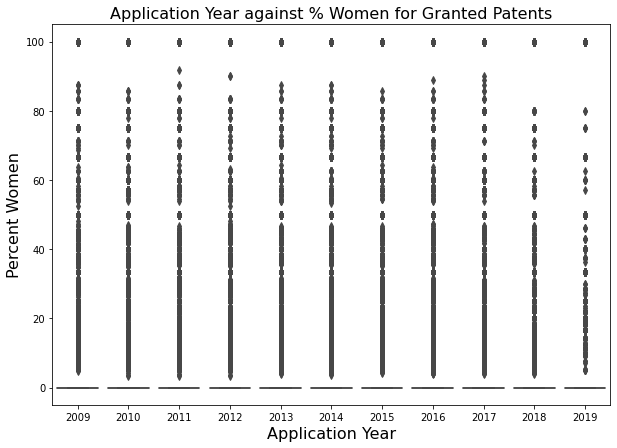

In [29]:
# box plot to compare incomes by gender
plt.figure(figsize = (10,7))
sns.boxplot(x = 'application_year', y = 'percent_women', data = data.query("application_year >= 2009 & already_granted == 1"))
plt.title("Application Year against % Women for Granted Patents", fontsize = 16)
plt.xlabel("Application Year", fontsize = 16)
plt.ylabel("Percent Women", fontsize = 16)

Text(0, 0.5, 'Percent Men')

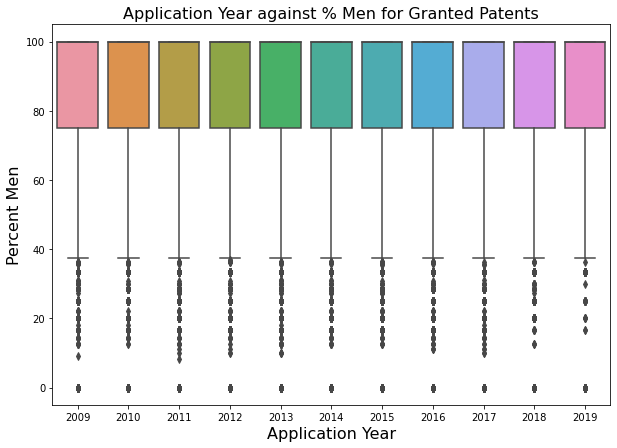

In [30]:
# box plot to compare incomes by gender
plt.figure(figsize = (10,7))
sns.boxplot(x = 'application_year', y = 'percent_men', data = data.query("application_year >= 2009 & already_granted == 1"))
plt.title("Application Year against % Men for Granted Patents", fontsize = 16)
plt.xlabel("Application Year", fontsize = 16)
plt.ylabel("Percent Men", fontsize = 16)

Text(0, 0.5, 'Percent Women')

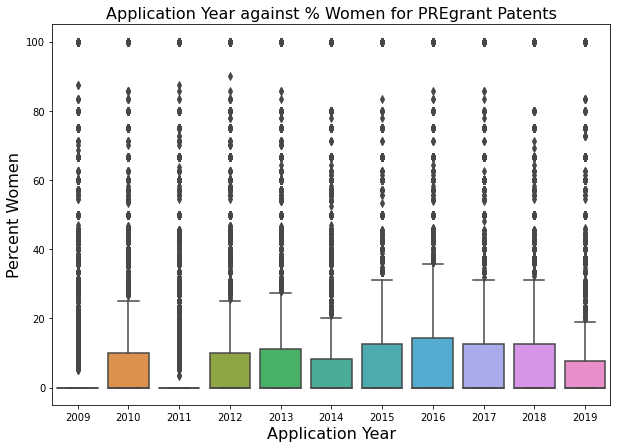

In [31]:
# box plot to compare incomes by gender
plt.figure(figsize = (10,7))
sns.boxplot(x = 'application_year', y = 'percent_women', data = data.query("application_year >= 2009 & already_granted == 0"))
plt.title("Application Year against % Women for PREgrant Patents", fontsize = 16)
plt.xlabel("Application Year", fontsize = 16)
plt.ylabel("Percent Women", fontsize = 16)

Text(0, 0.5, 'Percent Men')

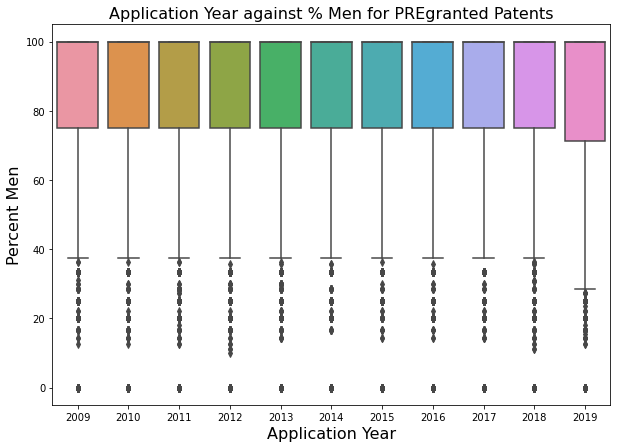

In [32]:
# box plot to compare incomes by gender
plt.figure(figsize = (10,7))
sns.boxplot(x = 'application_year', y = 'percent_men', data = data.query("application_year >= 2009 & already_granted == 0"))
plt.title("Application Year against % Men for PREgranted Patents", fontsize = 16)
plt.xlabel("Application Year", fontsize = 16)
plt.ylabel("Percent Men", fontsize = 16)

In [15]:
#sns.jointplot(x = 'women_inventors', y = 'men_inventors', kind='kde',
#              data = data.query("application_year >= 2009 & already_granted == 1"))


Text(0.5, 1.0, 'Men vs Women Inventors')

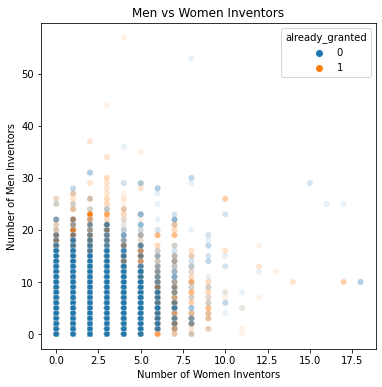

In [33]:
plt.figure(figsize = (6,6))
sns.scatterplot(x = 'women_inventors', y = 'men_inventors', data = data.query("application_year >= 2009"),
               hue = 'already_granted', alpha = 0.1)
plt.xlabel('Number of Women Inventors')
plt.ylabel('Number of Men Inventors')
plt.title('Men vs Women Inventors')

/Applications/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:670: UserWarning:

Using the barplot function without specifying `order` is likely to produce an incorrect plot.



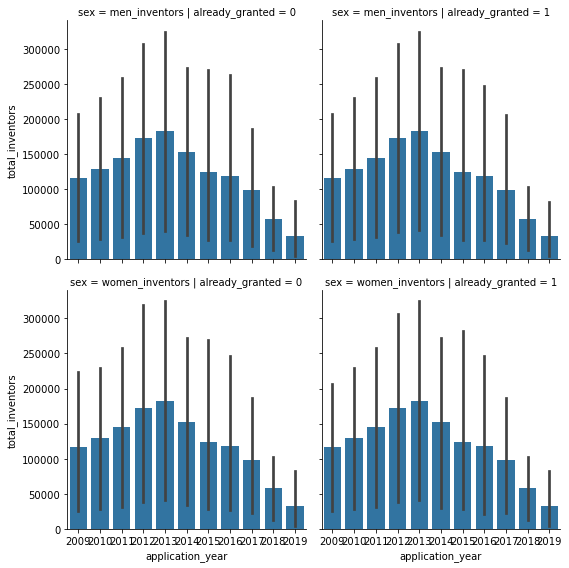

In [34]:
g = sns.FacetGrid(sex_hist, row = 'sex', col = 'already_granted',  height=4, aspect=1)
#g.map(sns.distplot, 'application_year', kde=False)
g.map(sns.barplot,x = 'application_year', y ='total_inventors', data = sex_hist)
#sns.barplot(x = 'application_year', y ='total_inventors', hue='sex', data=sex_hist)


In [18]:
# g = sns.FacetGrid(anes_hist, col = 'candidate', 
#                   col_wrap=2, height=4, aspect=1,
#                  hue='candidate')
# g.map(sns.distplot, 'thermometer', kde=False)
# g.set_titles('{col_name}')
# g.set_axis_labels('Thermometer rating', 'Frequency') 
# g.fig.subplots_adjust(top=.9)
# g.fig.suptitle('Feeling Thermometer Distributions', fontsize=16)

In [35]:
sex_by_year_and_status = data.query("application_year >= 2009").groupby(['application_year', 'already_granted']).\
agg({'men_inventors':{'count','sum','mean'},'women_inventors':{'count','sum','mean'},'percent_women':'mean'}).reset_index(level = [0,1])

In [20]:
# !pip install plotly-geo==1.0.0
# !pip install geopandas==0.3.0
# !pip install pyshp==1.2.10
# !pip install shapely==1.6.3


In [36]:
map_data = data.query("application_year >= 2009").groupby(['GEOID'], 
             as_index = False).size()#.sort_values(by ='size', ascending = False)
map_data.sort_values(by ='size', ascending = False)

,GEOID,size
2451,6085,152027
1418,36119,99986
127,06085,77315
2272,53033,64588
932,25017,57342
...,...,...
1040,27057,1
1044,27065,1
2109,5001,1
1046,27071,1


In [37]:
map_data.GEOID = map_data.GEOID.str.rjust(5, '0')
#(map_data.GEOID.str.len() == 5).sum() -> all 5 digits now

<AxesSubplot:xlabel='size'>

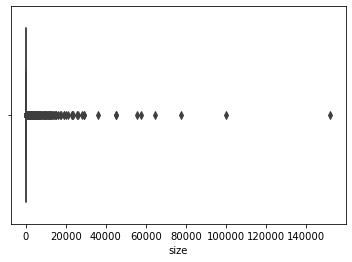

In [38]:
sns.boxplot(x = 'size', data = map_data)

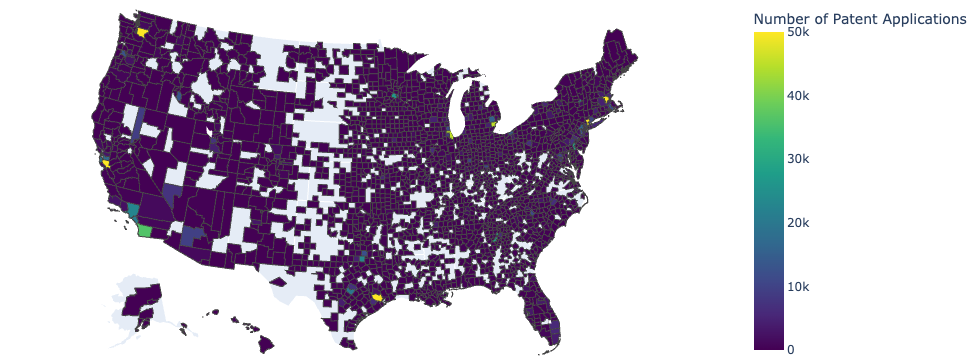

In [42]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

# import pandas as pd
# df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
#                    dtype={"fips": str})

import plotly.express as px

fig = px.choropleth(map_data, geojson=counties, locations='GEOID', color='size',
                           color_continuous_scale="Viridis",
                           # gives the range of the color scale
                           range_color=(0,50000),
                           # maybe county, state (especially for northeast)
                           # hover_data = 
                           scope="usa",
                           labels={'size':'Number of Patent Applications'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [45]:
map_data['log_number_patents'] = np.log(map_data['size'])
map_data.sort_values(by = 'log_number_patents')

,GEOID,size,log_number_patents
0,01001,1,0.000000
2051,48407,1,0.000000
821,21205,1,0.000000
1951,48071,1,0.000000
825,21215,1,0.000000
...,...,...,...
932,25017,57342,10.956789
2272,53033,64588,11.075784
127,06085,77315,11.255643
1418,36119,99986,11.512785


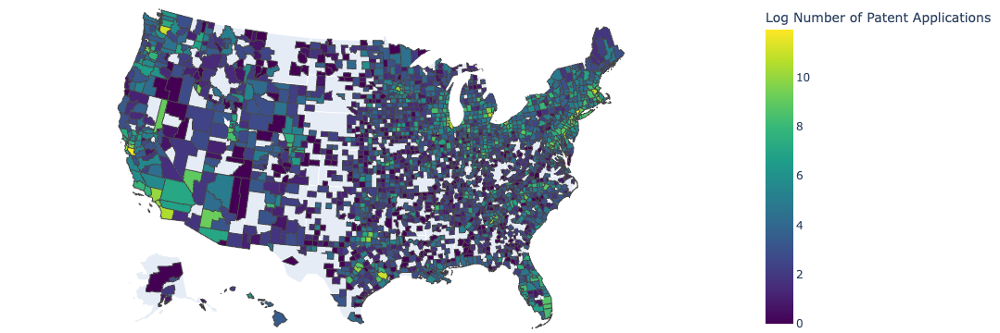

In [47]:
#by log patent number
fig2 = px.choropleth(map_data, geojson=counties, locations='GEOID', color='log_number_patents',
                           color_continuous_scale="Viridis",
                           # gives the range of the color scale
                           #range_color=(0,50000),
                           # maybe county, state (especially for northeast)
                           # hover_data = 
                           scope="usa",
                           labels={'log_number_patents':'Log Number of Patent Applications'}
                          )
fig2.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig2.show()

In [ ]:
#cook IL
data.query("GEOID == '17031'").assignee.value_counts()